John Klein: 10044346  
Kristian Rehn: 10043938

In [1]:
%pip install tensorboard

In [2]:
import os

import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import FashionMNIST

from torch.utils.tensorboard import SummaryWriter
from tensorboard import notebook


import matplotlib.pyplot as plt



random_seed = 42
torch.manual_seed(random_seed)

BATCH_SIZE=128
AVAIL_GPUS = min(1, torch.cuda.device_count())
NUM_WORKERS=2

In [3]:
notebook.start("--logdir=runs")

<IPython.core.display.Javascript object>

Mean: 0.3813875913619995,  
Standard Deviation: 0.3994404971599579

#Task 1.1

In [4]:
import os
import torch
from torchvision import transforms
from torchvision.datasets import FashionMNIST
from torch.utils.data import DataLoader, random_split

class MNISTDataLoader:
    def __init__(self, data_dir="./data", batch_size=128, num_workers=1):
        self.data_dir = data_dir
        self.batch_size = batch_size
        self.num_workers = num_workers

        # Define the transformation
        self.transform = transforms.Compose(
            [
                transforms.ToTensor(),
                transforms.Normalize((0.3813,), (0.3994,)),  # Mean and StdDev for FashionMNIST
            ]
        )

        # Initialize placeholders for datasets
        self.mnist_train = None
        self.mnist_val = None
        self.mnist_test = None

    def prepare_data(self):
        # Download datasets if not already present
        FashionMNIST(self.data_dir, train=True, download=True)
        FashionMNIST(self.data_dir, train=False, download=True)

    def setup(self, stage=None):
        # Assign train/val datasets
        if stage == "fit" or stage is None:
            mnist_full = FashionMNIST(self.data_dir, train=True, transform=self.transform)
            self.mnist_train, self.mnist_val = random_split(mnist_full, [55000, 5000])

        # Assign test dataset
        if stage == "test" or stage is None:
            self.mnist_test = FashionMNIST(self.data_dir, train=False, transform=self.transform)

    def get_train_dataloader(self):
        return DataLoader(self.mnist_train, batch_size=self.batch_size, num_workers=self.num_workers, shuffle=True)

    def get_val_dataloader(self):
        return DataLoader(self.mnist_val, batch_size=self.batch_size, num_workers=self.num_workers)

    def get_test_dataloader(self):
        return DataLoader(self.mnist_test, batch_size=self.batch_size, num_workers=self.num_workers)

In [5]:
def get_fashion_mnist_dataloader(data_dir="./data", batch_size=128, num_workers=1):
    # Define the transformation
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.3813,), (0.3994,))  # Mean and StdDev for FashionMNIST
    ])

    # Load the dataset
    train_dataset = FashionMNIST(root=data_dir, train=True, download=True, transform=transform)

    # Create the DataLoader
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)

    return train_loader

In [6]:
dataloader = get_fashion_mnist_dataloader()

100%|██████████| 26.4M/26.4M [00:02<00:00, 8.82MB/s]


Extracting ./data/FashionMNIST/raw/train-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 29.5k/29.5k [00:00<00:00, 137kB/s]


Extracting ./data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 4.42M/4.42M [00:01<00:00, 2.54MB/s]


Extracting ./data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



100%|██████████| 5.15k/5.15k [00:00<00:00, 5.03MB/s]

Extracting ./data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



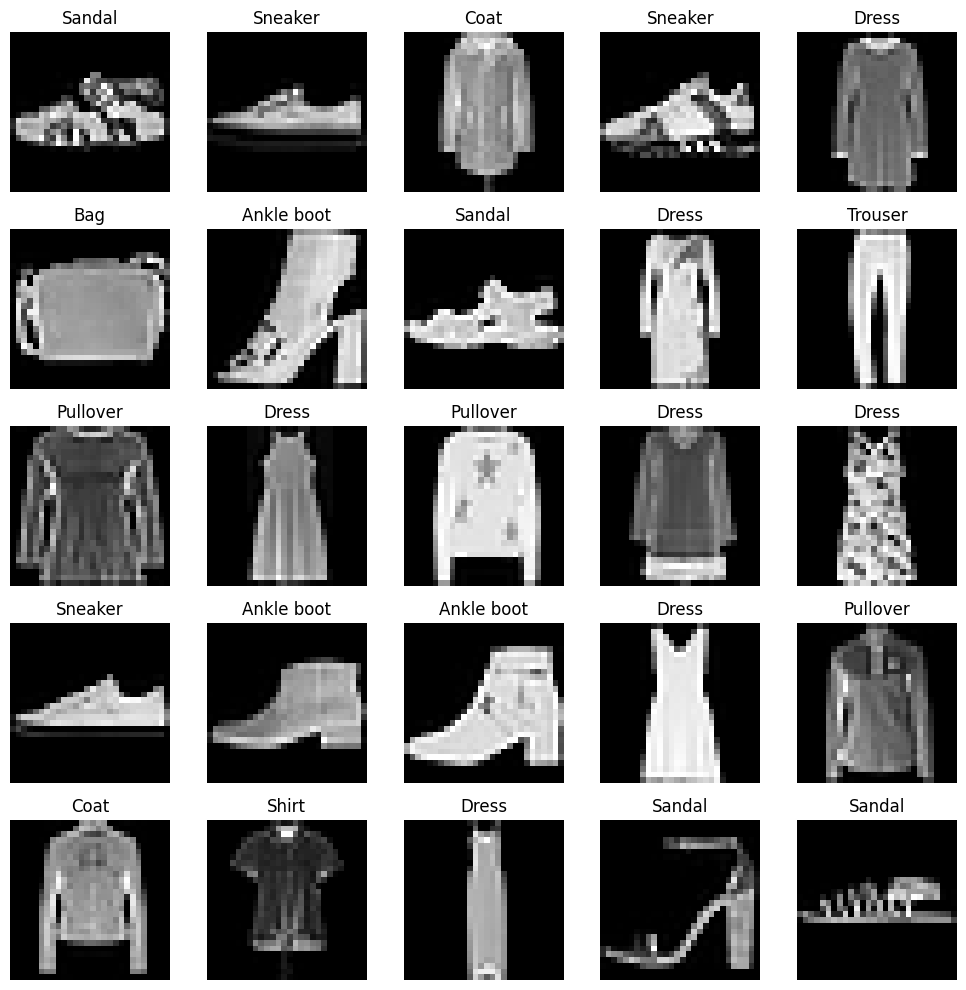

In [8]:
import matplotlib.pyplot as plt
import numpy as np

# Function to display images in a grid
def display_images(images, labels, classes):
    fig, axes = plt.subplots(5, 5, figsize=(10, 10))
    axes = axes.ravel()
    for i in range(25):
        axes[i].imshow(images[i].squeeze(), cmap="gray")
        axes[i].set_title(classes[labels[i]])
        axes[i].axis("off")
    plt.tight_layout()
    plt.show()

# Get a batch of data from the DataLoader
images, labels = next(iter(dataloader))

# Define class names
classes = [
    "T-shirt/top",
    "Trouser",
    "Pullover",
    "Dress",
    "Coat",
    "Sandal",
    "Shirt",
    "Sneaker",
    "Bag",
    "Ankle boot",
]


# Display the images
display_images(images, labels, classes)

# Task 1.2

In [42]:
# Generate Fake Data: output like real data [1, 28, 28] and values -1, 1
class Generator(nn.Module):
    def __init__(self, latent_dim):
        super().__init__()
        self.lin1 = nn.Linear(latent_dim, 7*7*64)  # [n, 256, 7, 7]
        self.ct1 = nn.ConvTranspose2d(64, 32, 4, stride=2) # [n, 64, 16, 16]
        self.ct2 = nn.ConvTranspose2d(32, 16, 4, stride=2) # [n, 16, 34, 34]
        self.conv = nn.Conv2d(16, 1, kernel_size=7)  # [n, 1, 28, 28]

        self.lin1.apply(self.weights_init)
        self.ct1.apply(self.weights_init)
        self.ct2.apply(self.weights_init)
        self.conv.apply(self.weights_init)

    def forward(self, x):
        # Pass latent space input into linear layer and reshape
        x = self.lin1(x)
        x = F.relu(x)
        x = x.view(-1, 64, 7, 7)  #256

        # Upsample (transposed conv) 16x16 (64 feature maps)
        x = self.ct1(x)
        x = F.relu(x)

        # Upsample to 34x34 (16 feature maps)
        x = self.ct2(x)
        x = F.relu(x)

        # Convolution to 28x28 (1 feature map)
        x = self.conv(x)
        x = torch.tanh(x)
        return x

    # Task 1.3.1 find best initialization
    def weights_init(self,m):
        if isinstance(m, nn.Conv2d) or isinstance(m,nn.ConvTranspose2d):
            nn.init.normal_(m.weight.data, 0.0, 0.02) # works good for Conv
        elif isinstance(m, nn.Linear):
            torch.nn.init.xavier_uniform(m.weight) # Works "best" for Linear
            m.bias.data.fill_(0.01)

In [41]:
# Detective: fake or no fake -> 1 output [0, 1]
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        # Simple CNN
        self.conv1 = nn.Conv2d(1, 10, kernel_size=5)
        self.conv2 = nn.Conv2d(10, 20, kernel_size=5)
        self.conv2_drop = nn.Dropout2d()
        self.fc1 = nn.Linear(320, 50)
        self.fc2 = nn.Linear(50, 1)

        self.conv1.apply(self.weights_init)
        self.conv2.apply(self.weights_init)
        self.fc1.apply(self.weights_init)
        self.fc2.apply(self.weights_init)

    def forward(self, x):
        x = F.leaky_relu(F.max_pool2d(self.conv1(x), 2))
        x = F.leaky_relu(F.max_pool2d(self.conv2_drop(self.conv2(x)), 2))
        # Flatten the tensor so it can be fed into the FC layers
        x = x.view(-1, 320)
        x = F.leaky_relu(self.fc1(x))
        x = F.dropout(x, training=self.training)
        x = self.fc2(x)
        return torch.sigmoid(x)

        # Task 1.3.1 find best initialization
    def weights_init(self, m):
        if isinstance(m, nn.Conv2d):
            nn.init.normal_(m.weight.data, 0.0, 0.02) # works best for Conv
        elif isinstance(m, nn.Linear):
            torch.nn.init.xavier_uniform(m.weight) # Works "best" for Linear
            m.bias.data.fill_(0.01)

## Task 1.2.3:

At the beginning I used the tutorial from PyTorch (https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html). However, I did not really get results with it (see pictures BatchNorm_X). After that I tried to improve this approach and got results when I removed the BatchNorm layers and added a conv2d layer. With the Discriminator I also removed the BatchNorm layers to get results and i tried a dropout layer to get some more randomniss and it worked quite well

Translated with www.DeepL.com/Translator (free version)

## 1.3.1: How does initialisation affect training?

The biggest difference in training was between deterministic and non-deterministic initializations. In a visual assessment, the deterministic initializations performed worse.  To find an initialization, I waited for the first three epochs and then evaluated them. For linear layers, xavier_uniform worked very well, no big difference was found for the bias, which is why I simply took 0.01. For the convolution layers a normal distribution worked quite well.

In [15]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

class GAN:
    def __init__(self, generator, discriminator, latent_dim=100, lr=0.0002):
        self.latent_dim = latent_dim
        self.lr = lr
        self.generator = generator
        self.discriminator = discriminator
        self.g_losses = []
        self.d_losses = []

        # Optimizers
        self.opt_g = torch.optim.Adam(self.generator.parameters(), lr=self.lr)
        self.opt_d = torch.optim.Adam(self.discriminator.parameters(), lr=self.lr)

        # Random noise for validation
        self.validation_z = torch.randn(6, self.latent_dim)

        # Loss function
        self.adversarial_loss = nn.BCELoss()

        self.writer = SummaryWriter(log_dir="runs/gan_training")

    def train(self, dataloader, num_epochs, device):
        self.generator.to(device)
        self.discriminator.to(device)

        iteration = 0

        for epoch in range(num_epochs):
            for batch_idx, (real_imgs, _) in enumerate(dataloader):
                real_imgs = real_imgs.to(device)

                # Train Generator
                g_loss = self.train_generator(real_imgs, device)
                self.g_losses.append(g_loss.item())

                # Train Discriminator
                d_loss = self.train_discriminator(real_imgs, device)
                self.d_losses.append(d_loss.item())


                # Log losses to TensorBoard
                self.writer.add_scalar("Generator Loss", g_loss.item(), iteration)
                self.writer.add_scalar("Discriminator Loss", d_loss.item(), iteration)
                iteration += 1



            # End of epoch
            print(f"Epoch {epoch + 1}/{num_epochs}, Generator Loss: {g_loss.item()}, Discriminator Loss: {d_loss.item()}")
            self.plot_imgs(device, epoch)
        self.writer.close()

    def train_generator(self, real_imgs, device):
        """Train the generator."""
        self.opt_g.zero_grad()
        z = torch.randn(real_imgs.size(0), self.latent_dim).to(device)
        fake_imgs = self.generator(z)
        g_loss = self._generator_loss(fake_imgs)
        g_loss.backward()
        self.opt_g.step()
        return g_loss

    def train_discriminator(self, real_imgs, device):
        """Train the discriminator."""
        self.opt_d.zero_grad()
        z = torch.randn(real_imgs.size(0), self.latent_dim).to(device)
        fake_imgs = self.generator(z).detach()
        d_loss = self._discriminator_loss(real_imgs, fake_imgs)
        d_loss.backward()
        self.opt_d.step()
        return d_loss

    def _generator_loss(self, fake_imgs):
        y = torch.ones(fake_imgs.size(0), 1).to(fake_imgs.device)
        y_hat = self.discriminator(fake_imgs)
        return self.adversarial_loss(y_hat, y)

    def _discriminator_loss(self, real_imgs, fake_imgs):
        # Real images
        y_real = torch.ones(real_imgs.size(0), 1).to(real_imgs.device)
        y_hat_real = self.discriminator(real_imgs)
        real_loss = self.adversarial_loss(y_hat_real, y_real)

        # Fake images
        y_fake = torch.zeros(fake_imgs.size(0), 1).to(fake_imgs.device)
        y_hat_fake = self.discriminator(fake_imgs)
        fake_loss = self.adversarial_loss(y_hat_fake, y_fake)

        return real_loss + fake_loss

    def plot_imgs(self, device, epoch):
        z = self.validation_z.to(device)
        sample_imgs = self.generator(z).cpu()

        print(f"Epoch {epoch + 1}: Generated Samples")
        fig = plt.figure(figsize=(10, 5))
        for i in range(sample_imgs.size(0)):
            plt.subplot(2, 3, i + 1)
            plt.tight_layout()
            plt.imshow(sample_imgs.detach()[i, 0, :, :], cmap='gray_r', interpolation='none')
            plt.title("Generated Data")
            plt.xticks([])
            plt.yticks([])
        plt.show()


    def plot_losses(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.g_losses, label="Generator Loss")
        plt.plot(self.d_losses, label="Discriminator Loss")
        plt.xlabel("Iterations")
        plt.ylabel("Loss")
        plt.title("Generator and Discriminator Loss During Training")
        plt.legend()
        plt.show()



In [38]:
generator = Generator(latent_dim=100)
discriminator = Discriminator()

In [39]:
dm = MNISTDataLoader(num_workers=1)
model = GAN(generator=generator, discriminator=discriminator, latent_dim=100, lr=0.0002)

Epoch 1/20, Generator Loss: 1.4352830648422241, Discriminator Loss: 0.8899326324462891
Epoch 1: Generated Samples


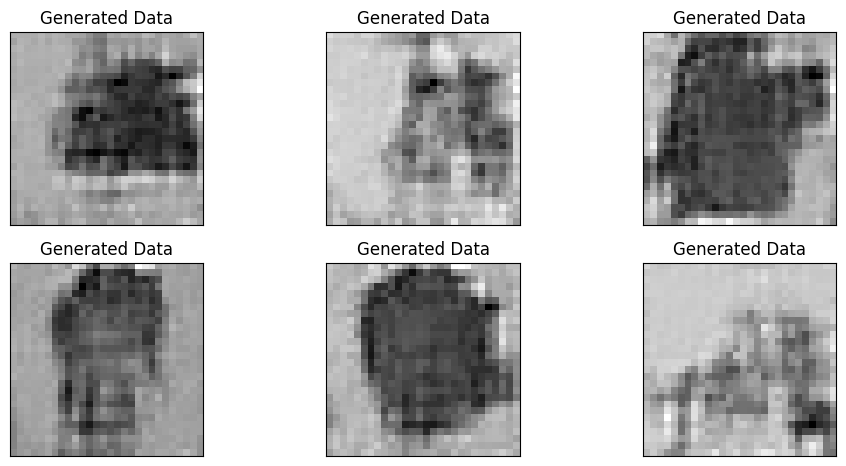

Epoch 2/20, Generator Loss: 1.5385857820510864, Discriminator Loss: 0.9508434534072876
Epoch 2: Generated Samples


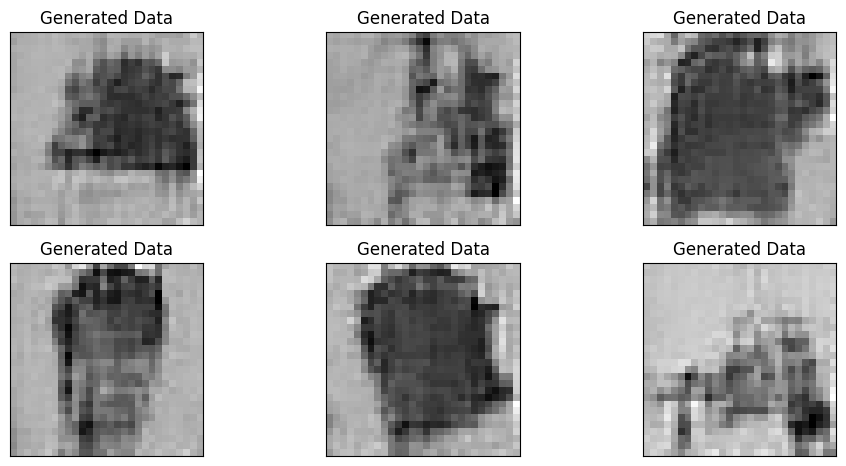

Epoch 3/20, Generator Loss: 1.4227265119552612, Discriminator Loss: 0.8875080943107605
Epoch 3: Generated Samples


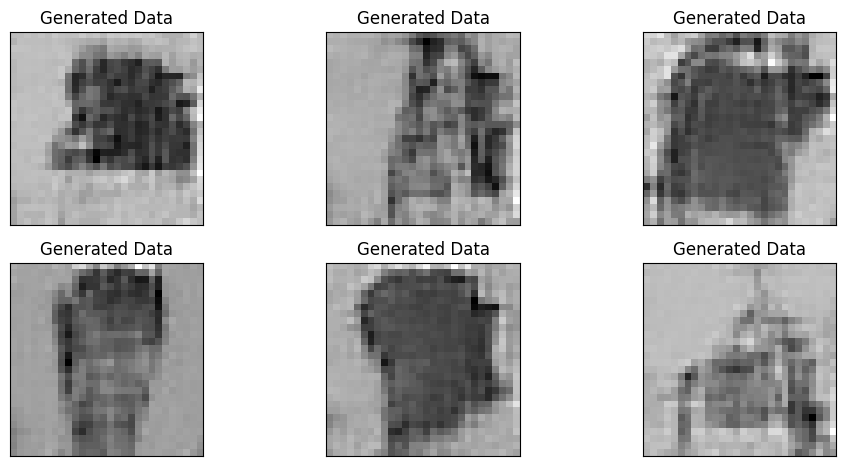

Epoch 4/20, Generator Loss: 1.4041332006454468, Discriminator Loss: 0.8124353289604187
Epoch 4: Generated Samples


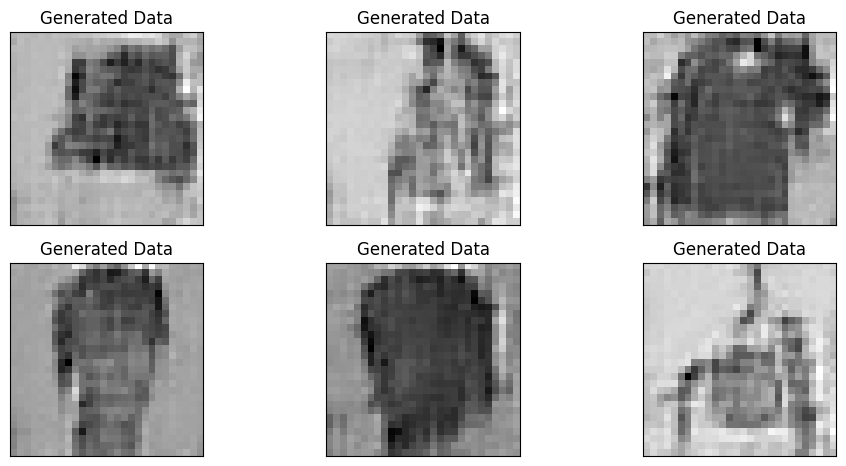

Epoch 5/20, Generator Loss: 1.2696723937988281, Discriminator Loss: 0.9895432591438293
Epoch 5: Generated Samples


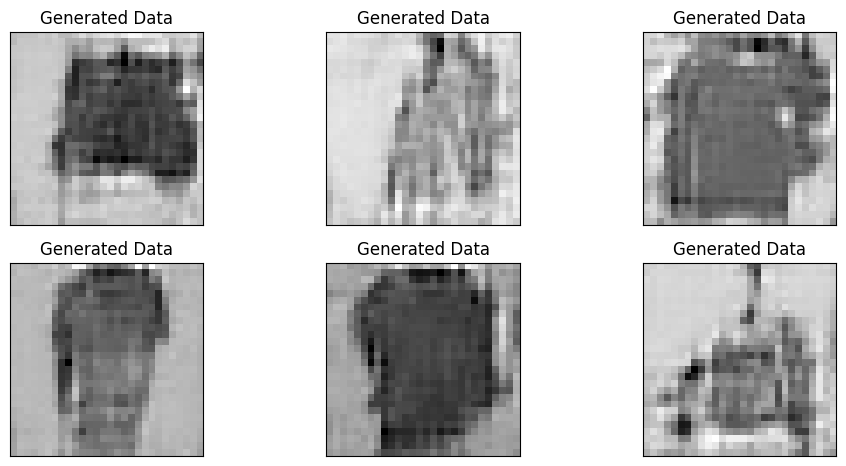

Epoch 6/20, Generator Loss: 1.4456418752670288, Discriminator Loss: 0.8630273342132568
Epoch 6: Generated Samples


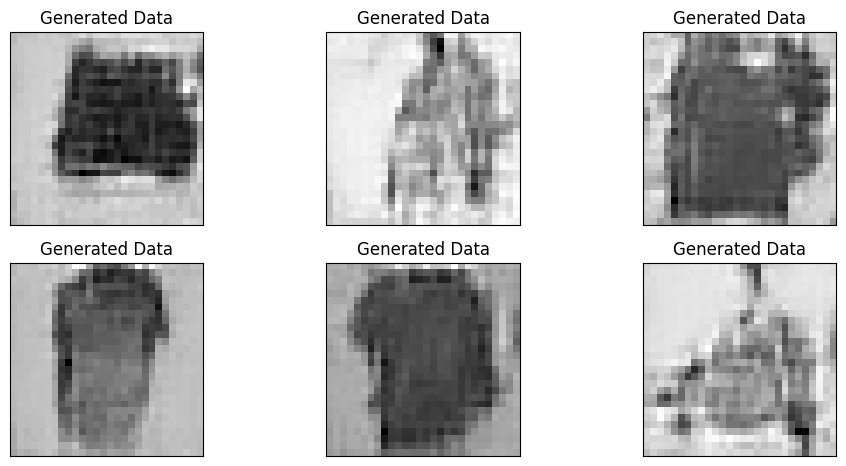

Epoch 7/20, Generator Loss: 1.7008843421936035, Discriminator Loss: 0.9129342436790466
Epoch 7: Generated Samples


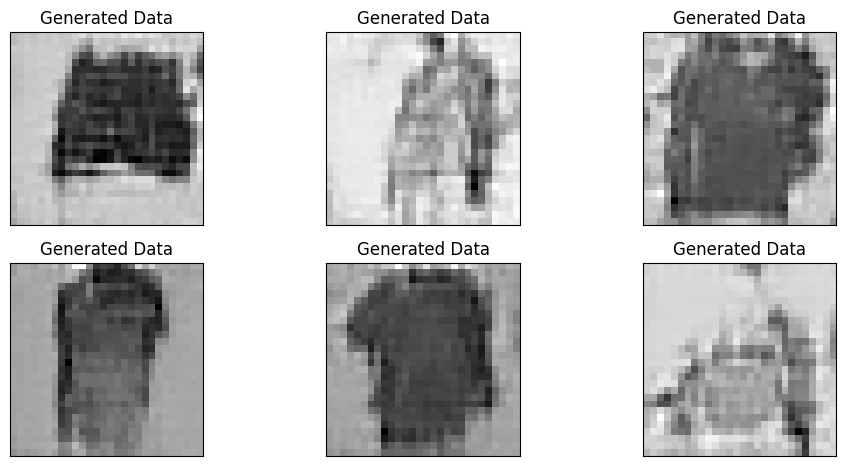

Epoch 8/20, Generator Loss: 1.3193202018737793, Discriminator Loss: 1.0173676013946533
Epoch 8: Generated Samples


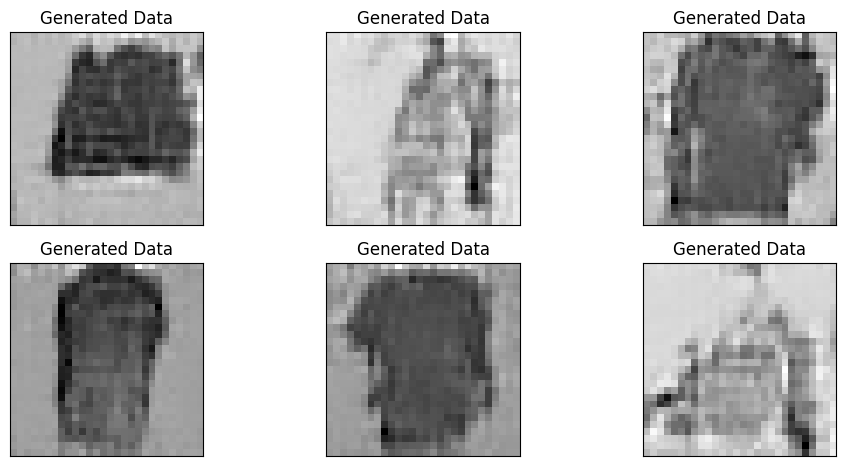

Epoch 9/20, Generator Loss: 1.2889047861099243, Discriminator Loss: 0.8274102210998535
Epoch 9: Generated Samples


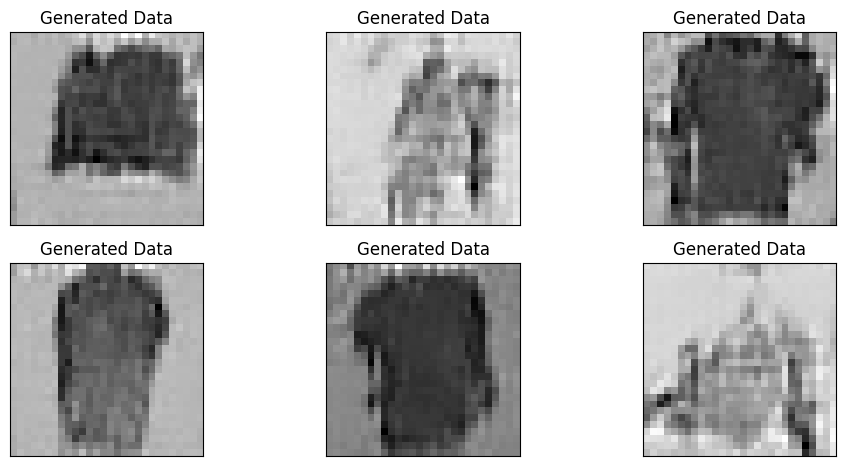

Epoch 10/20, Generator Loss: 1.0852584838867188, Discriminator Loss: 0.874729335308075
Epoch 10: Generated Samples


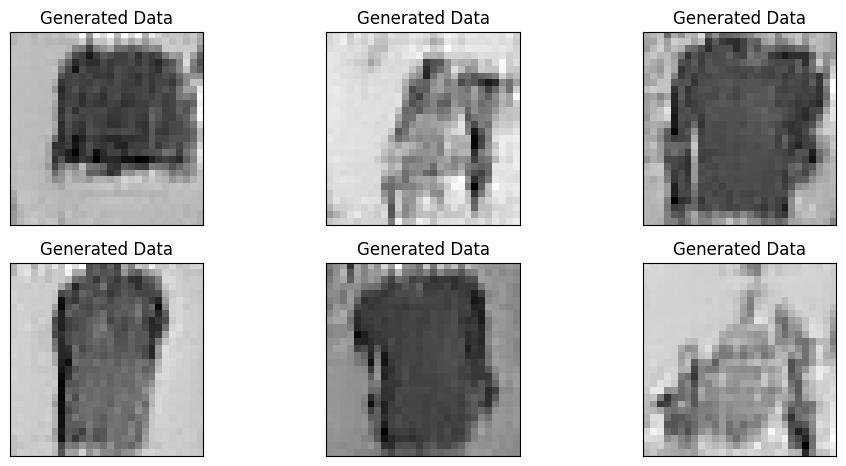

Epoch 11/20, Generator Loss: 1.3129180669784546, Discriminator Loss: 1.0156433582305908
Epoch 11: Generated Samples


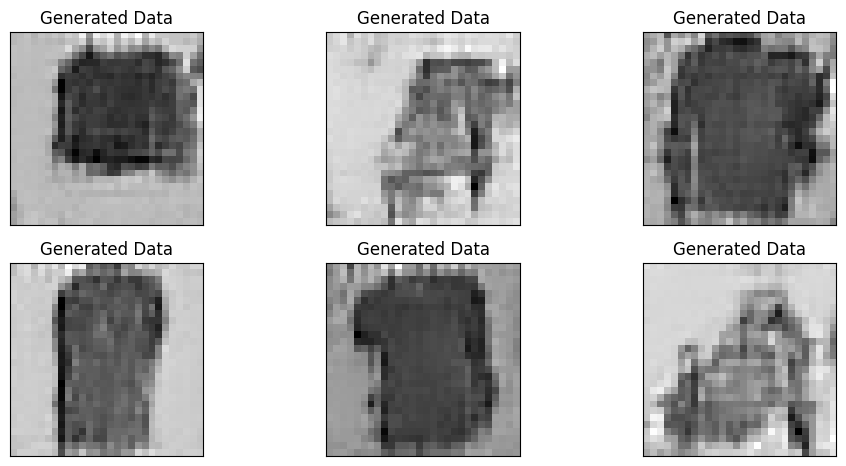

Epoch 12/20, Generator Loss: 1.3360310792922974, Discriminator Loss: 1.1802070140838623
Epoch 12: Generated Samples


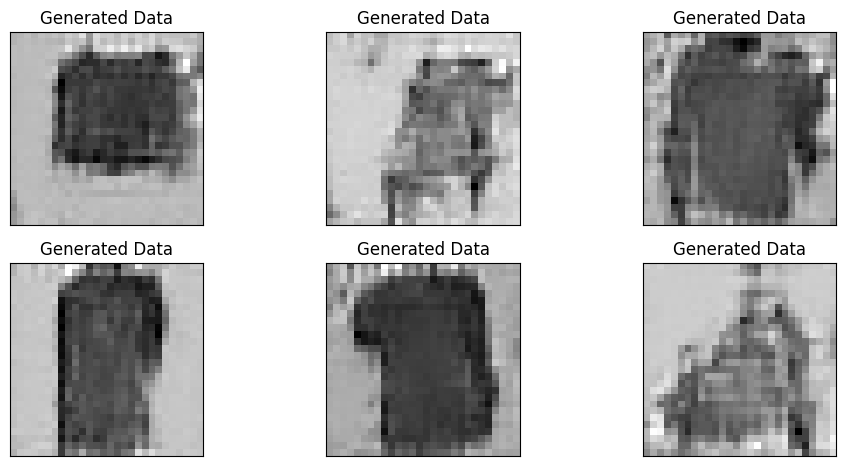

Epoch 13/20, Generator Loss: 1.273271918296814, Discriminator Loss: 1.0466092824935913
Epoch 13: Generated Samples


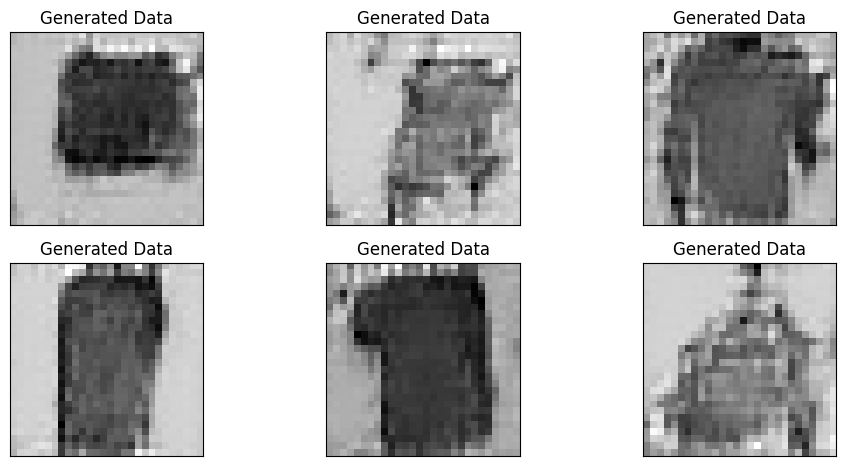

Epoch 14/20, Generator Loss: 1.1918541193008423, Discriminator Loss: 0.8404331803321838
Epoch 14: Generated Samples


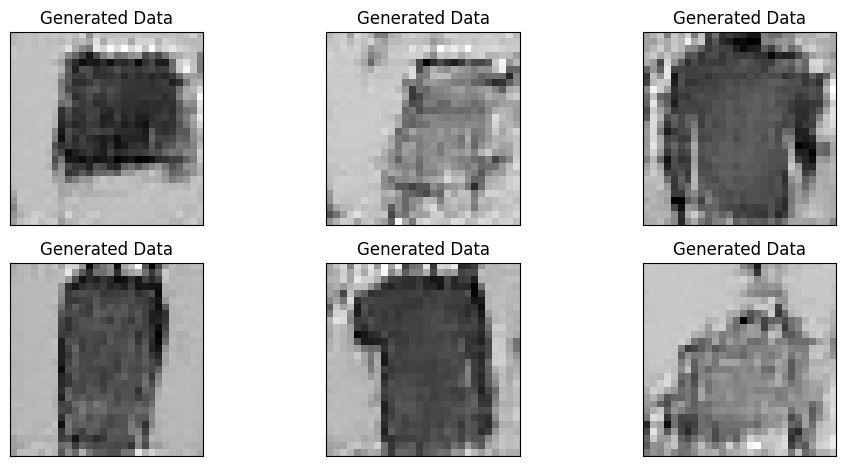

Epoch 15/20, Generator Loss: 1.2714323997497559, Discriminator Loss: 1.0345429182052612
Epoch 15: Generated Samples


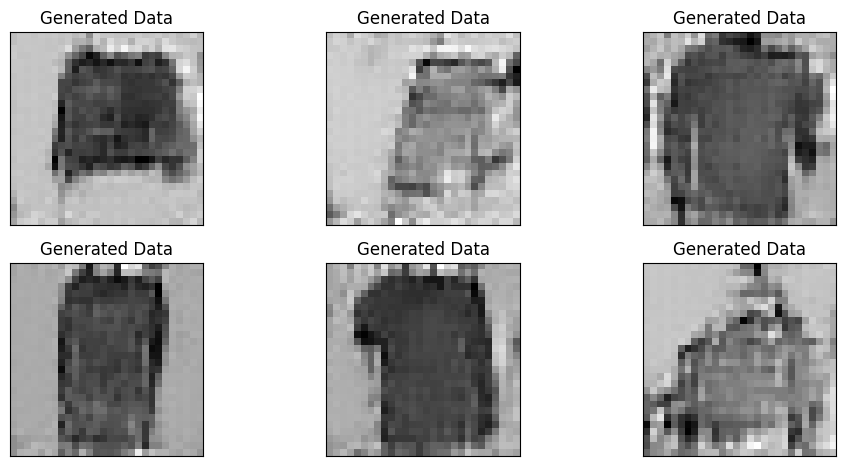

Epoch 16/20, Generator Loss: 1.28097665309906, Discriminator Loss: 1.1391143798828125
Epoch 16: Generated Samples


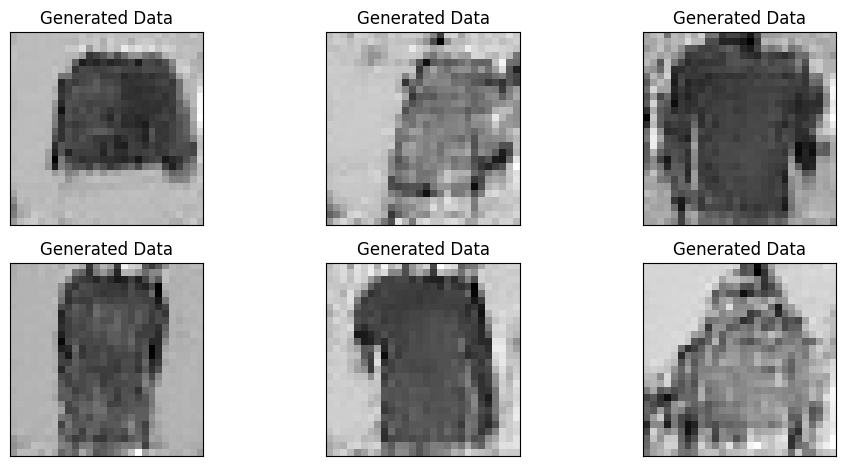

Epoch 17/20, Generator Loss: 1.2031737565994263, Discriminator Loss: 0.9867812395095825
Epoch 17: Generated Samples


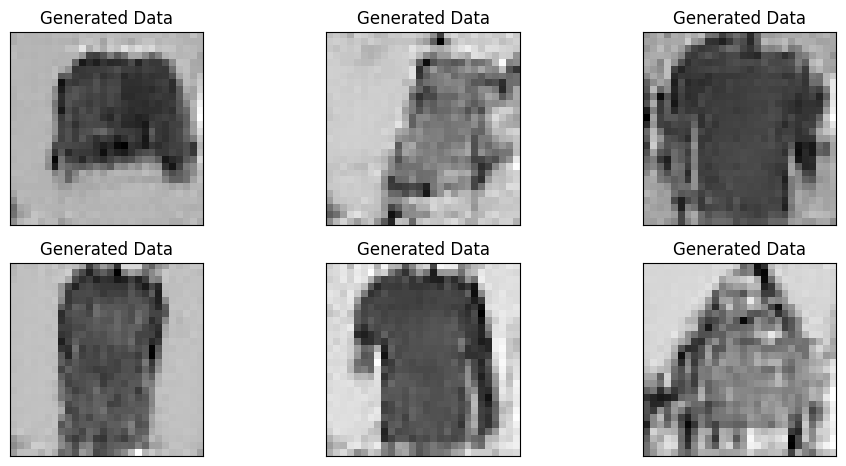

Epoch 18/20, Generator Loss: 1.2548242807388306, Discriminator Loss: 0.9022558927536011
Epoch 18: Generated Samples


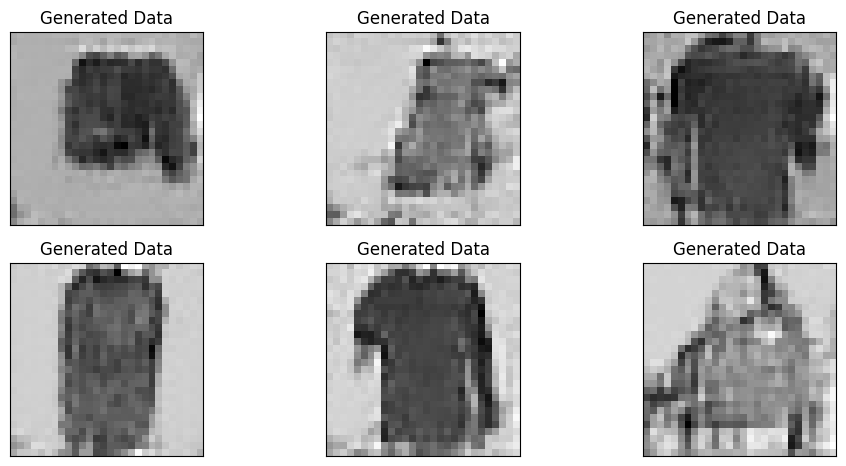

Epoch 19/20, Generator Loss: 1.3426376581192017, Discriminator Loss: 0.8162709474563599
Epoch 19: Generated Samples


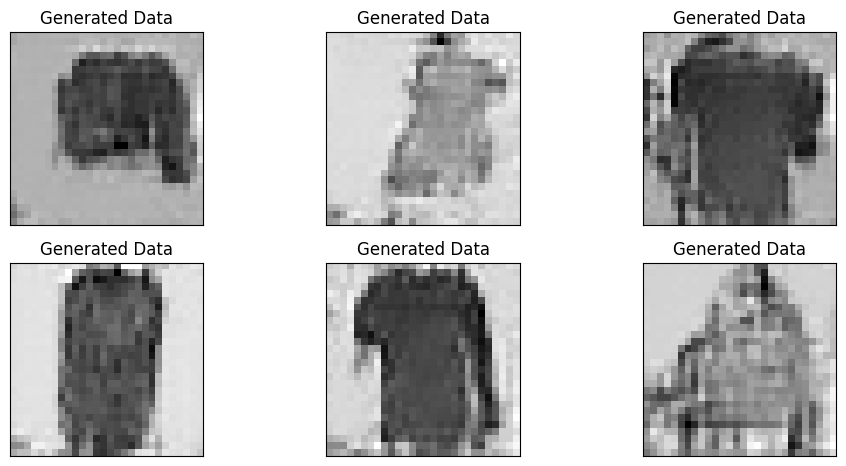

Epoch 20/20, Generator Loss: 1.3339184522628784, Discriminator Loss: 0.9820384979248047
Epoch 20: Generated Samples


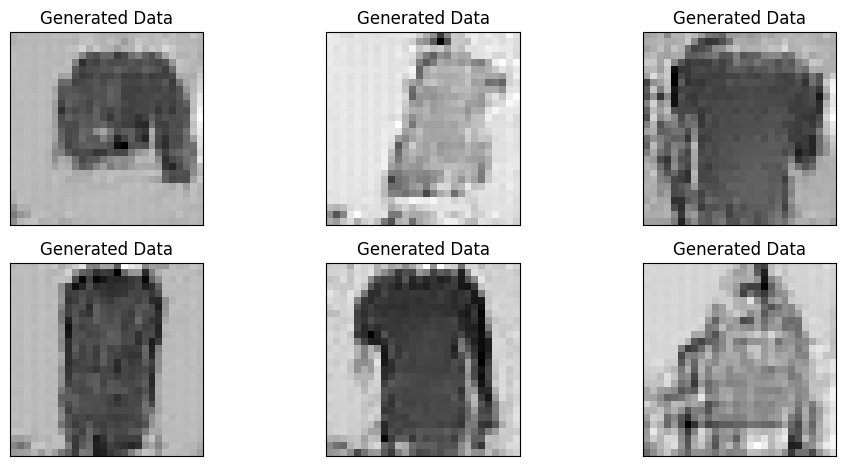

In [24]:
model.train(dataloader, num_epochs=20, device="cpu")

In [25]:
%load_ext tensorboard
%tensorboard --logdir=runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 425), started 2:26:48 ago. (Use '!kill 425' to kill it.)

<IPython.core.display.Javascript object>

## 1.3.3 Explain the adversarial loss used to train a GAN
The adversarial loss is caused by the interplay between the generator and the discriminator.  If the discriminator recognizes many of the generated objects, then the loss of the discriminator decreases and the loss of the generator increases because the objects have been recognized. It is the same the other way round if the generator generates many objects that go unnoticed. This results in the adversarial loss. Over time, however, both losses should go down as both get better and better.



## Task 1.4.1

In [34]:
import torch
import matplotlib.pyplot as plt

def display_generated_fashion_mnist(trained_gan, device, latent_dim=100, row=5, columns=5):
    trained_gan.generator.to(device)
    trained_gan.generator.eval()

    fig, axes = plt.subplots(row, columns, figsize=(columns * 2, row * 2))
    fig.suptitle("Generated Fashion MNIST Images", fontsize=16)

    with torch.no_grad():
        for category in range(row):
            for sample in range(columns):
                # Generate latent vectors
                z = torch.randn(1, latent_dim).to(device)
                # Generate fake image
                fake_image = trained_gan.generator(z).cpu().squeeze()
                # Display the image
                ax = axes[category, sample]
                ax.imshow(fake_image, cmap="gray")
                ax.axis("off")
                if sample == 0:
                    ax.set_ylabel(f"Class {category}", rotation=0, labelpad=30, fontsize=12)

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()


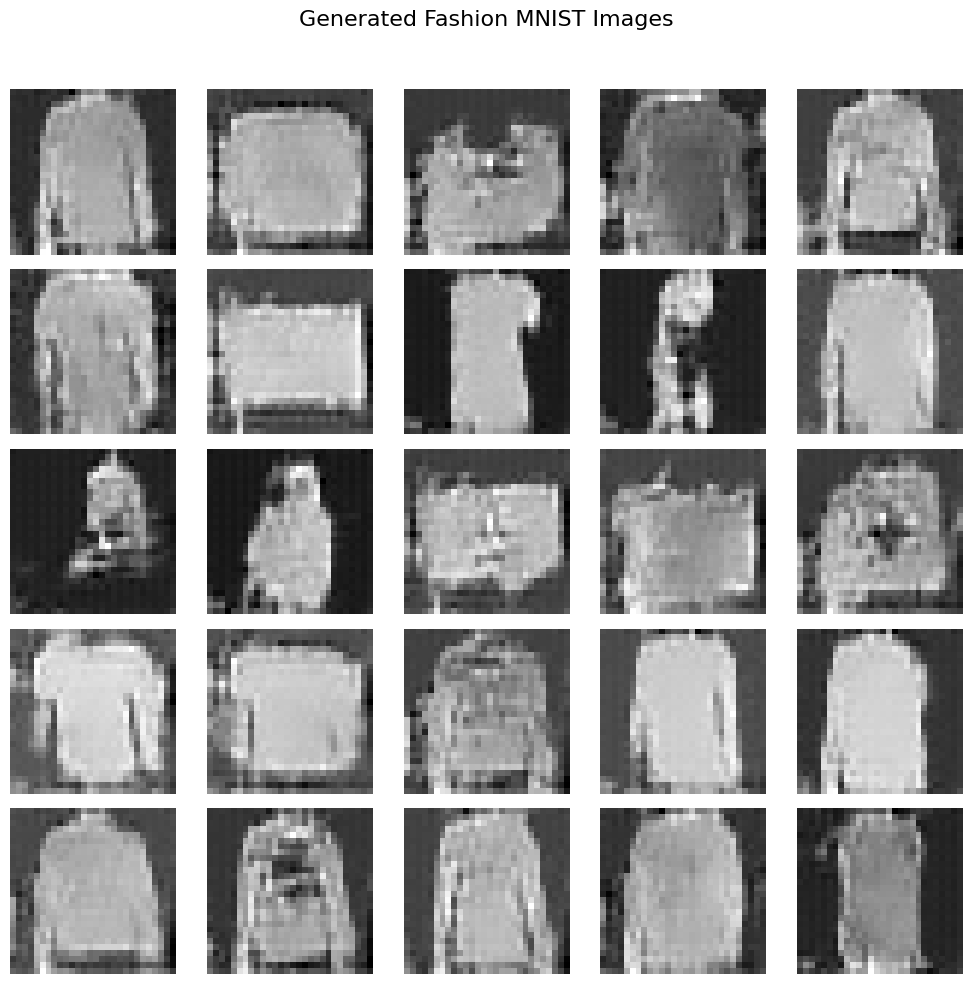

In [35]:
display_generated_fashion_mnist(model, device="cpu")

## 1.4.2 Challanges:

1. It was hard to test much, because one iteration took around 4-5 min. I tried to reduce the data set but than the final result was much worse than expected, so I stuck with the large data set.

2. The evaluation is also more like "this looks better, i thing" than real evaluation

3. I had problems designing the discriminator loss function. In the beginning I had the problem that the discriminator was almost perfect from the start, which meant that the generator could not be trained properly. I then tried a few things, e.g. pre-training the generator in some way, changing the discriminator only every x iterations...
Then at some point I realized that I forgot to give real images to the discriminator, which of course always made it right for the discriminator to guess that the given image is generated. The generator was therefore always recognized and the generated images no longer made any real sense. After that I was able to continue as normal.

# Task 2 VAE

In [43]:
from torch.utils.data import DataLoader
import torchvision.transforms as transforms

import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
import torch
from PIL import Image
from torch.utils.data import TensorDataset, DataLoader
import torchvision
import torch.nn as nn
from torch.optim import Adam

from torchvision.datasets import CIFAR10
from tqdm import tqdm

# Task 1

In [44]:
# create a transofrm to apply to each datapoint
transform = transforms.Compose([transforms.ToTensor()])

# download the MNIST datasets
path = '/data'
train_dataset = CIFAR10(path, transform=transform, download=True)
test_dataset  = CIFAR10(path, transform=transform, download=True)

# create train and testt dataloaders
batch_size = 100
train_loader = DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

100%|██████████| 170M/170M [00:12<00:00, 13.6MB/s]


Extracting /data/cifar-10-python.tar.gz to /data
Files already downloaded and verified


In [45]:
device

device(type='cpu')

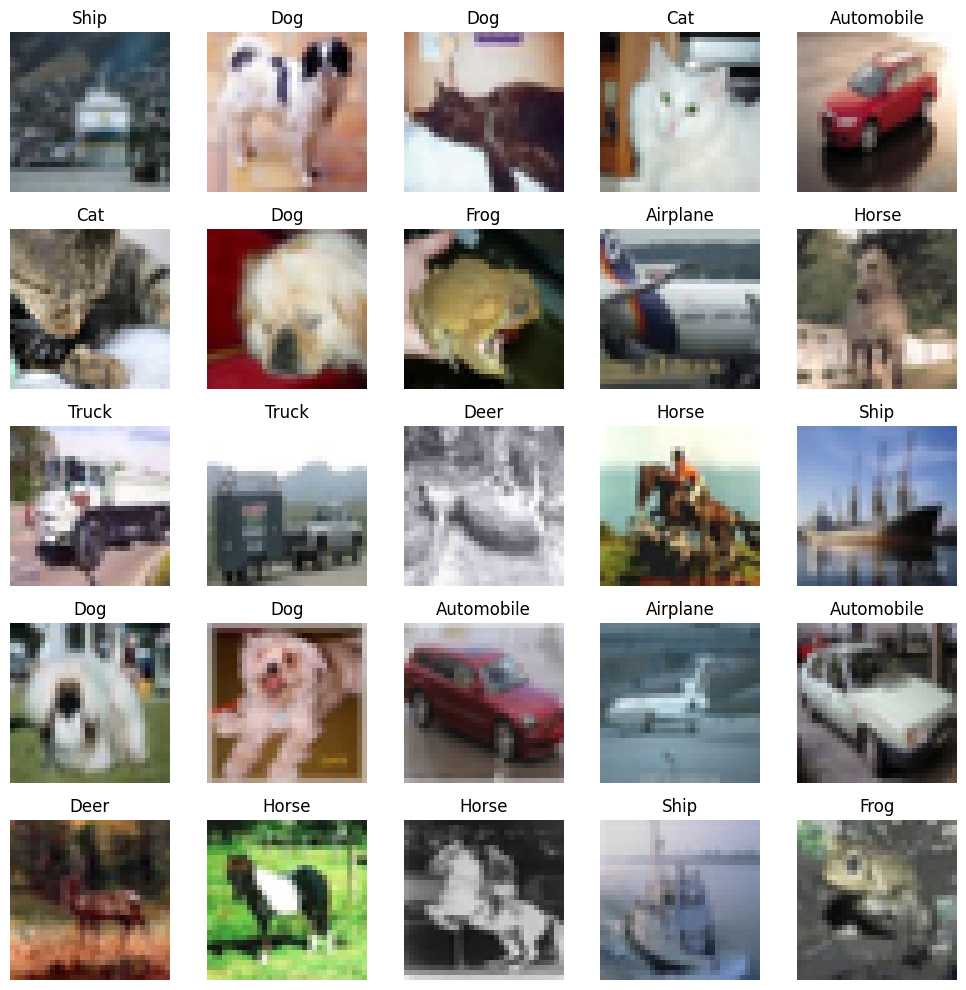

In [46]:
import matplotlib.pyplot as plt
import numpy as np

# Function to display images in a grid
def display_images(images, labels, classes):
    fig, axes = plt.subplots(5, 5, figsize=(10, 10))
    axes = axes.ravel()
    for i in range(25):
        #change dimensions to correct color
        img = np.transpose(images[i].numpy(), (1, 2, 0))
        axes[i].imshow(img)
        axes[i].set_title(classes[labels[i]])
        axes[i].axis("off")
    plt.tight_layout()
    plt.show()

images, labels = next(iter(train_loader))

classes = [
    "Airplane",
    "Automobile",
    "Bird",
    "Cat",
    "Deer",
    "Dog",
    "Frog",
    "Horse",
    "Ship",
    "Truck",
]

display_images(images, labels, classes)


# Task 2

## Explanation:

I used the design example from the exercise and tried some other adjustments, but these had little effect, so I only adjusted the numbers a little. I set the number of latent dimensions to 30. This is the point where the quality is no longer significantly increased and the number is not yet too high for the autoencoder to make sense

In [47]:
class Encoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, padding=1)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.lin1 = nn.Linear(32*8*8, 512)
        self.lin2 = nn.Linear(512, 30)

    def forward(self, inp):
        out = self.conv1(inp)
        out = self.relu(out)
        out = self.maxpool(out)
        out = self.conv2(out)
        out = self.relu(out)
        out = self.maxpool(out)
        out = out.reshape(inp.shape[0], -1)
        out = self.lin1(out)
        return self.lin2(self.relu(out))

In [48]:
encoder = Encoder()

In [49]:
for X, label in train_loader:
    X = X.to(torch.float32)
    out = encoder(X)
    break

In [50]:
out.shape

torch.Size([100, 30])

In [51]:
class Decoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.lin1 = nn.Linear(30, 256)
        self.lin2 = nn.Linear(256, 1024)
        self.lin3 = nn.Linear(1024, 3 * 32 * 32)
        self.relu = nn.ReLU()

    def forward(self, z):
        out = self.lin1(z)
        out = self.relu(out)
        out = self.lin2(out)
        out = self.relu(out)
        out = self.lin3(out)
        out = out.view(z.shape[0], 3, 32, 32)
        return out

In [52]:
decoder = Decoder()

In [53]:
for X, label in train_loader:
    X = X.to(torch.float32)
    print(X.shape)
    out = encoder(X)
    X_hat = decoder(out)
    print(X_hat.shape)
    break

torch.Size([100, 3, 32, 32])
torch.Size([100, 3, 32, 32])


In [54]:
class Autoencoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()

    def forward(self, inp):
        out = self.encoder(inp)
        return self.decoder(out)

# Task 3:
The mean squared error calculates the error in each data point by squaring the deviation and then calculating the average per point. By squaring it, we hoped that the larger deviations would be reduced and the general structures would be better represented.

In [55]:
auto_encoder = Autoencoder()
criterion = nn.MSELoss()
optimizer = Adam(auto_encoder.parameters(), lr=0.001)

# Task 4

In [56]:
def display_reconstructions(autoencoder, dataset, epoch, device):

    autoencoder.eval()

    classes = dataset.classes
    samples = {}
    for img, label in dataset:
        if label not in samples:
            samples[label] = img
        if len(samples) == len(classes):
            break

    sample_images = torch.stack([samples[i] for i in range(len(classes))])
    sample_images = sample_images.to(device)

    with torch.no_grad():
        reconstructed_images = autoencoder(sample_images)

    fig, axes = plt.subplots(2, len(classes), figsize=(15, 5))
    for i in range(len(classes)):
        # Original images
        axes[0, i].imshow(sample_images[i].cpu().permute(1, 2, 0))
        axes[0, i].set_title(f"Original: {classes[i]}")
        axes[0, i].axis("off")

        # Generated images
        axes[1, i].imshow(reconstructed_images[i].cpu().permute(1, 2, 0).numpy())
        axes[1, i].set_title("Reconstructed")
        axes[1, i].axis("off")

    plt.suptitle(f"Epoch {epoch + 1}: Original vs. Reconstructed", fontsize=16)
    plt.tight_layout()
    plt.show()


  0%|          | 0/30 [00:00<?, ?it/s]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


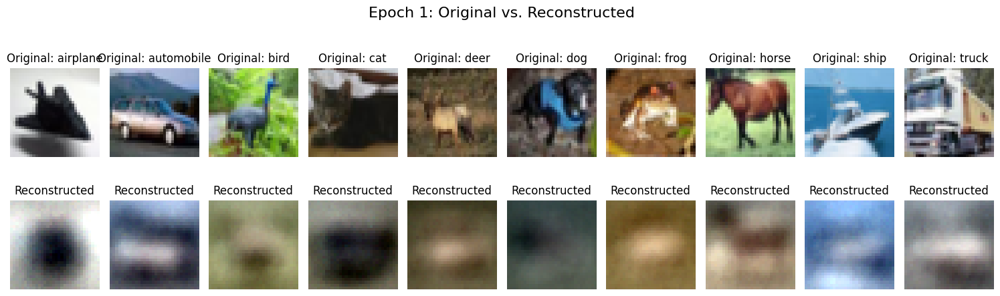

  3%|▎         | 1/30 [01:27<42:06, 87.12s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


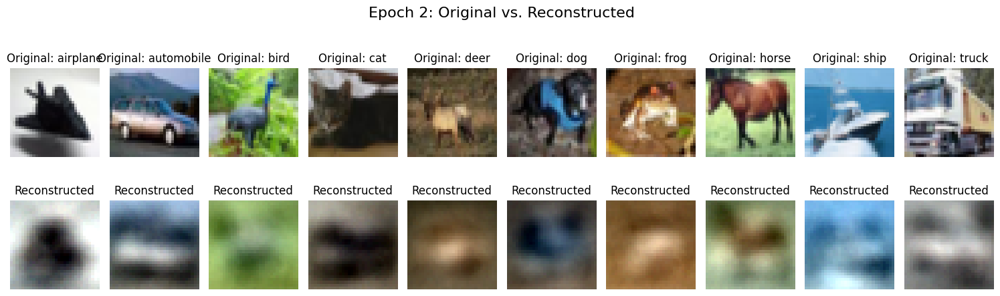

  7%|▋         | 2/30 [03:23<48:38, 104.23s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


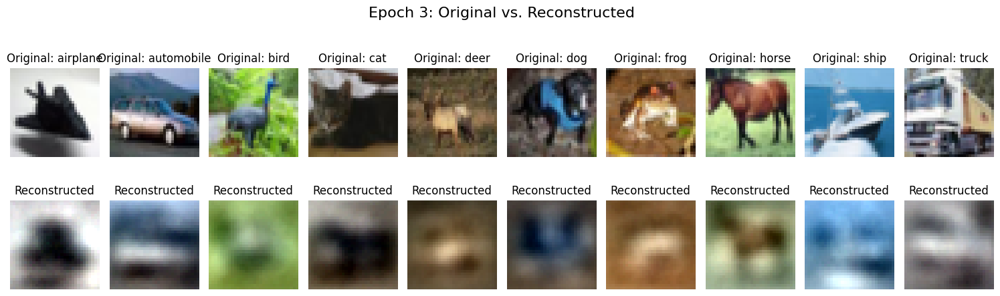

 10%|█         | 3/30 [05:21<49:49, 110.71s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


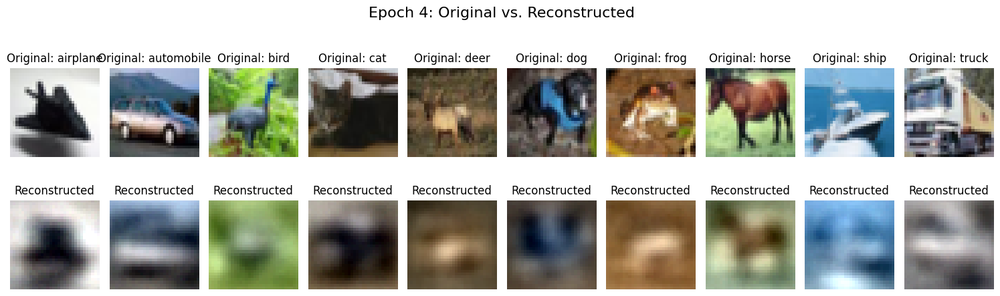

 13%|█▎        | 4/30 [07:18<48:57, 112.97s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


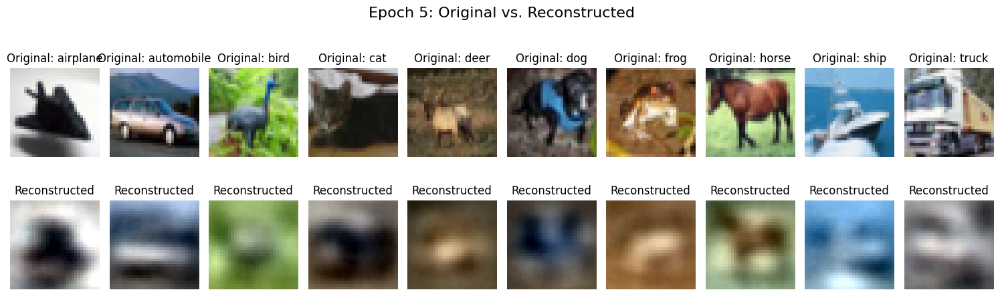

 17%|█▋        | 5/30 [09:13<47:24, 113.79s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


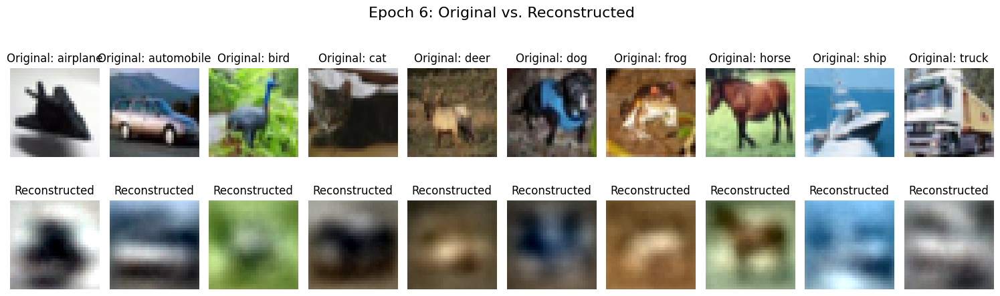

 20%|██        | 6/30 [11:08<45:42, 114.28s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


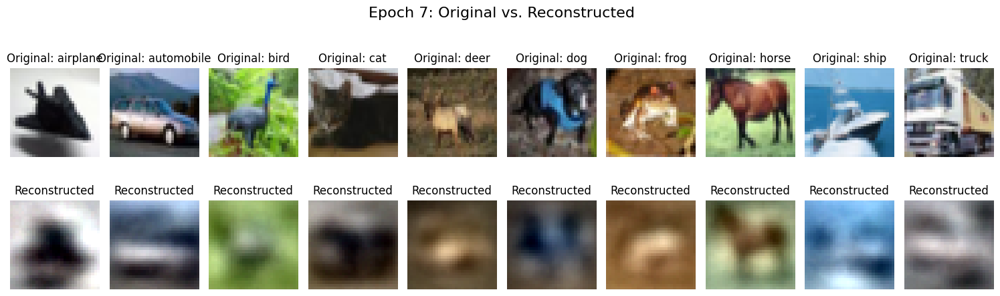

 23%|██▎       | 7/30 [13:05<44:05, 115.01s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


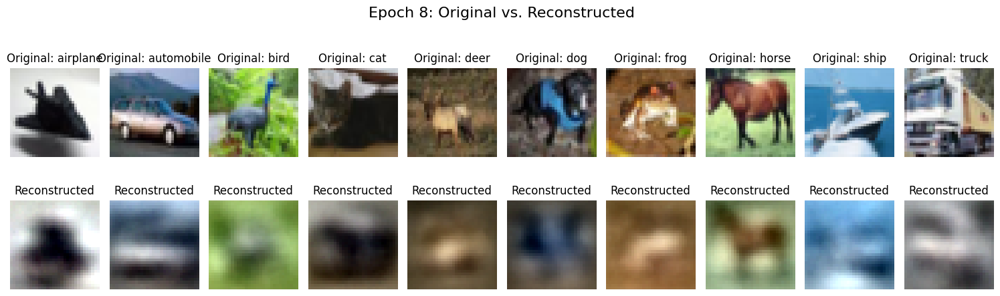

 27%|██▋       | 8/30 [15:01<42:17, 115.34s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


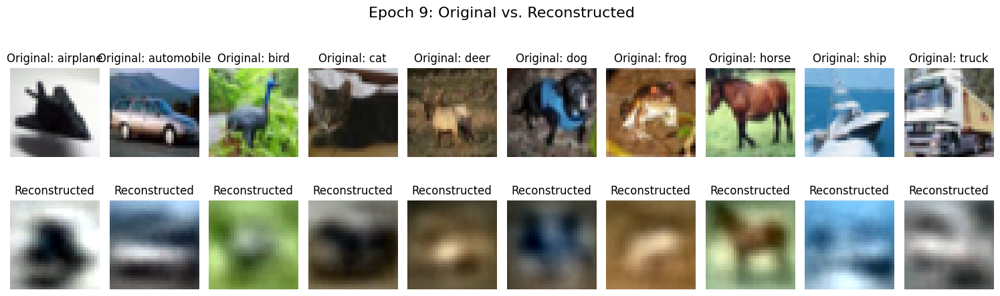

 30%|███       | 9/30 [16:57<40:26, 115.53s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


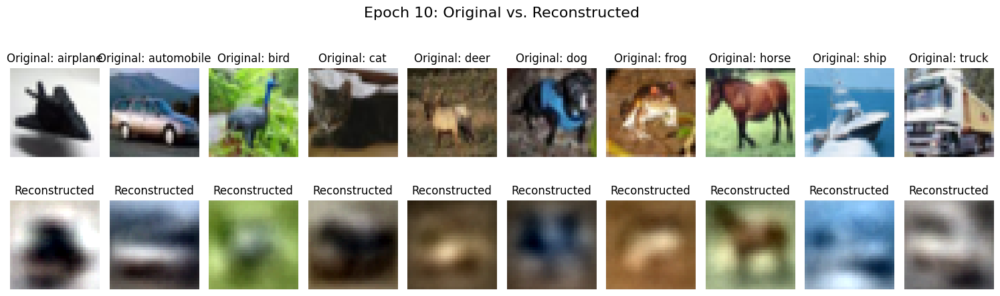

 33%|███▎      | 10/30 [18:52<38:27, 115.36s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


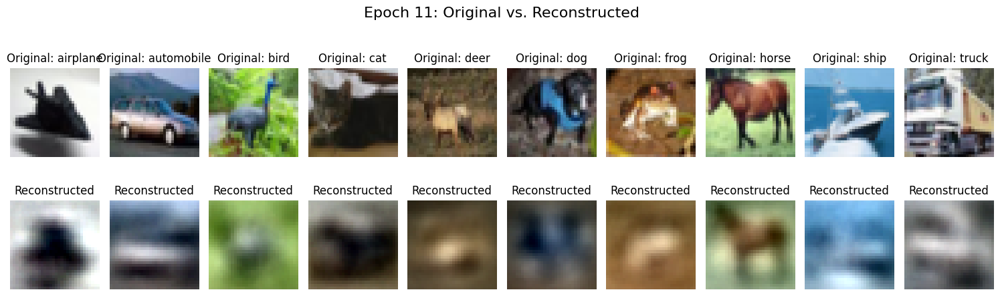

 37%|███▋      | 11/30 [20:48<36:36, 115.62s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


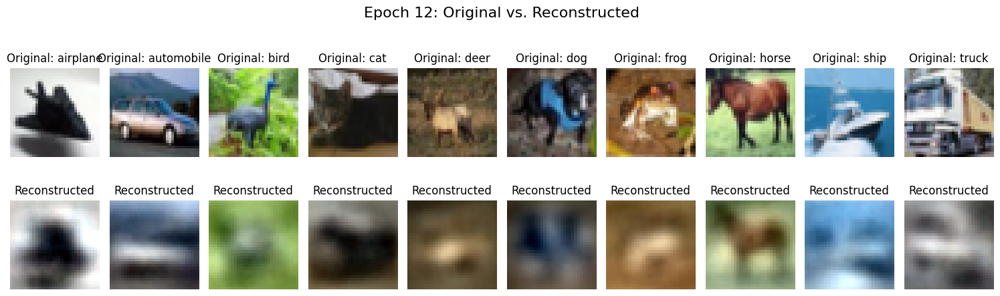

 40%|████      | 12/30 [22:44<34:41, 115.64s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


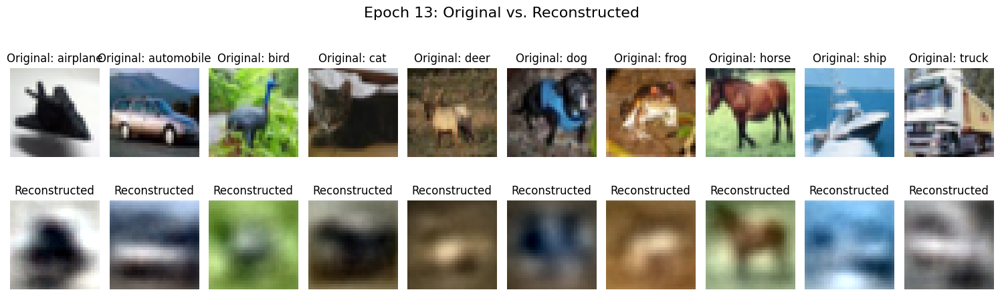

 43%|████▎     | 13/30 [24:39<32:44, 115.55s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


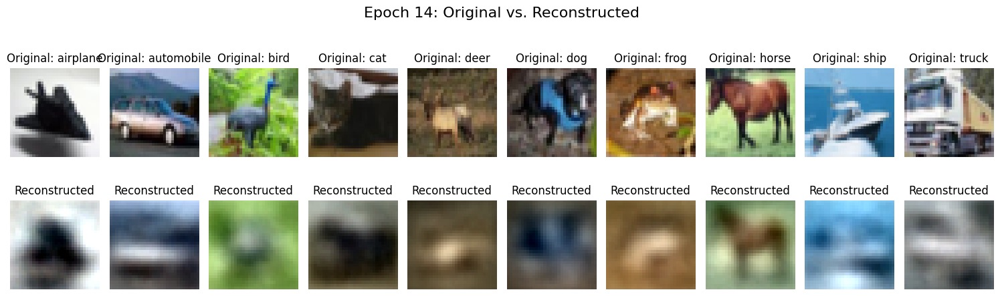

 47%|████▋     | 14/30 [26:35<30:50, 115.67s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


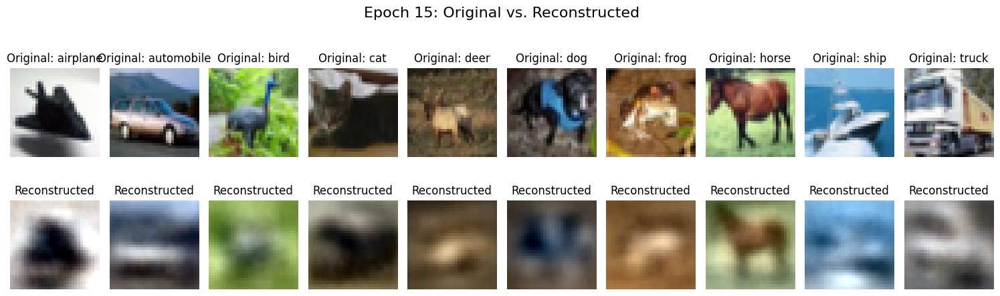

 50%|█████     | 15/30 [28:30<28:54, 115.62s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


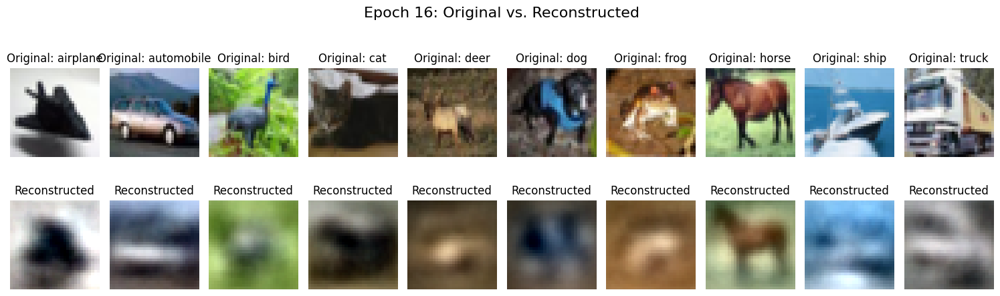

 53%|█████▎    | 16/30 [30:26<26:59, 115.64s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


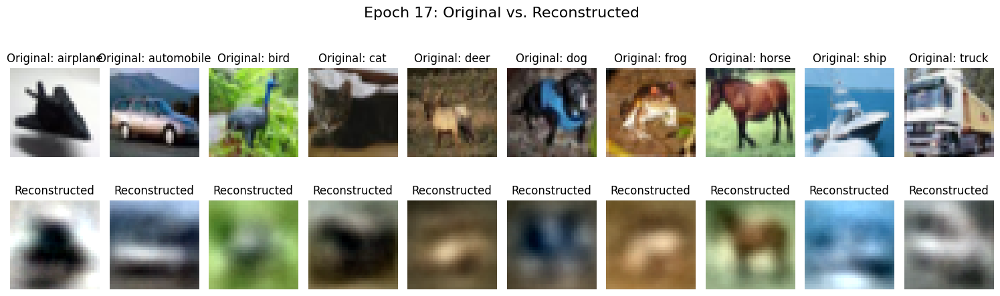

 57%|█████▋    | 17/30 [32:20<24:58, 115.23s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


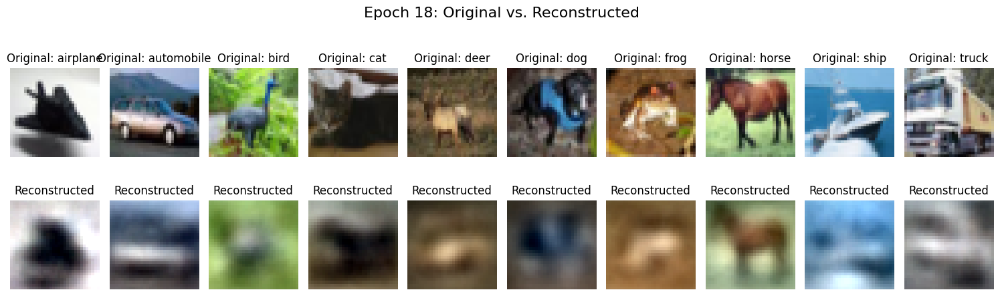

 60%|██████    | 18/30 [34:16<23:02, 115.23s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


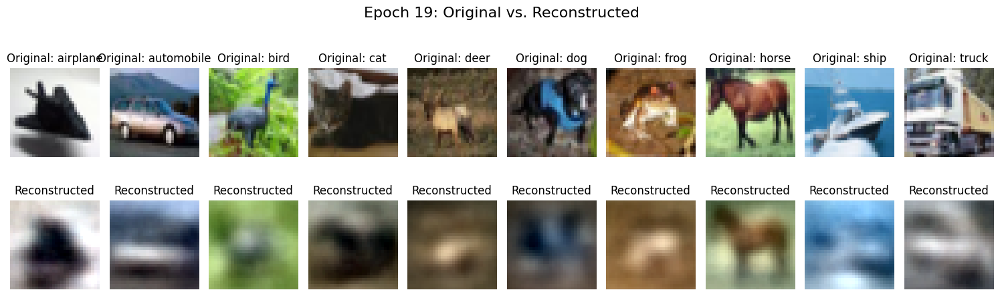

 63%|██████▎   | 19/30 [36:10<21:06, 115.14s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


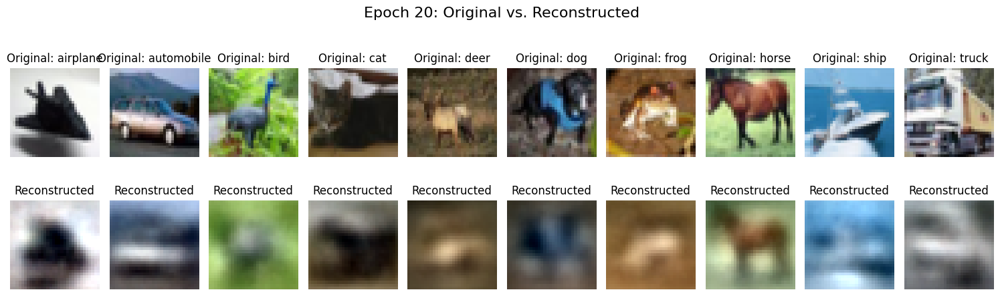

 67%|██████▋   | 20/30 [38:05<19:09, 114.95s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


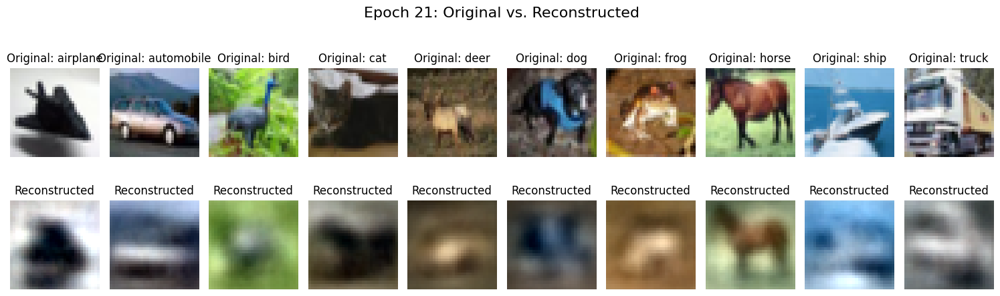

 70%|███████   | 21/30 [40:01<17:16, 115.21s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


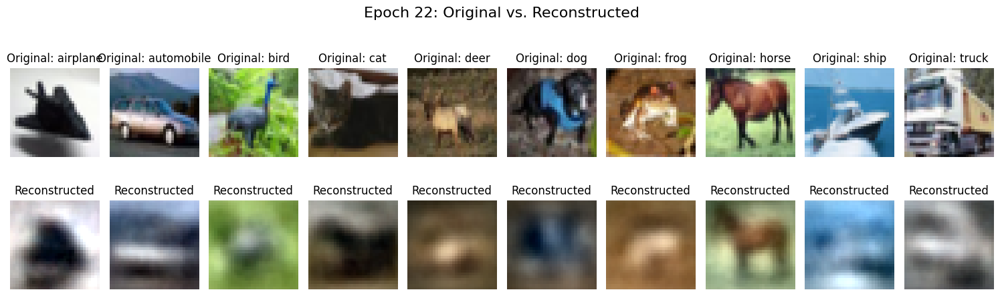

 73%|███████▎  | 22/30 [41:56<15:20, 115.06s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


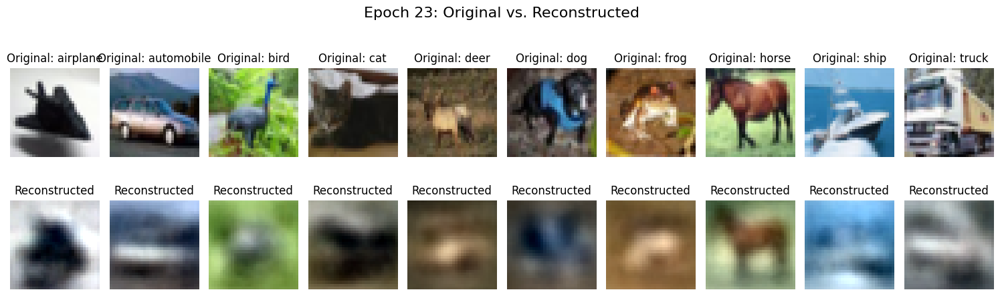

 77%|███████▋  | 23/30 [43:50<13:24, 114.97s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


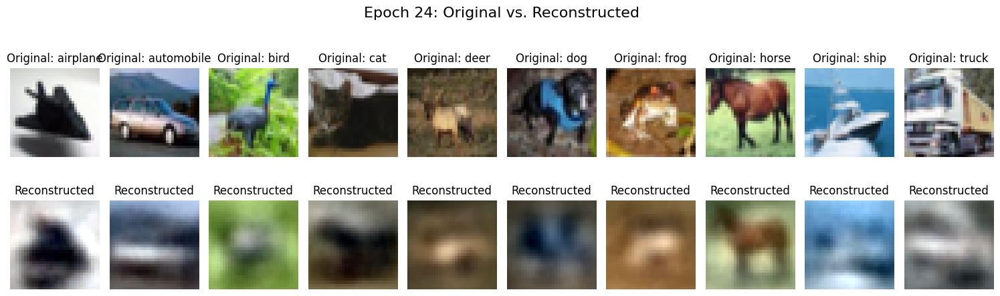

 80%|████████  | 24/30 [45:46<11:30, 115.15s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


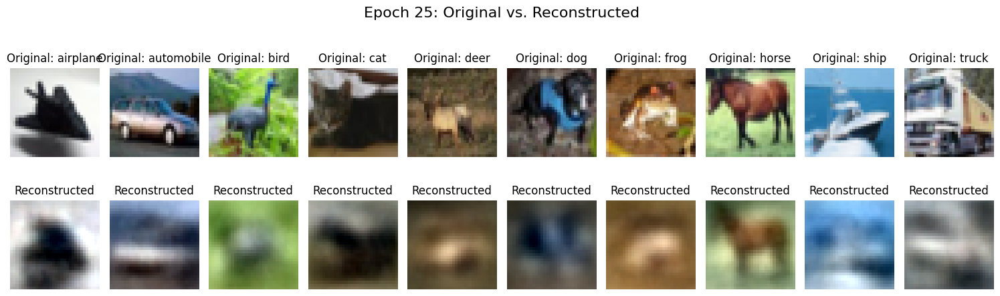

 83%|████████▎ | 25/30 [47:41<09:35, 115.07s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


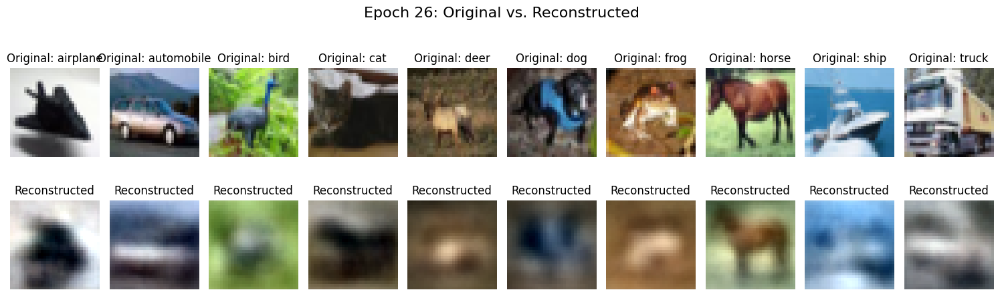

 87%|████████▋ | 26/30 [49:36<07:40, 115.11s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


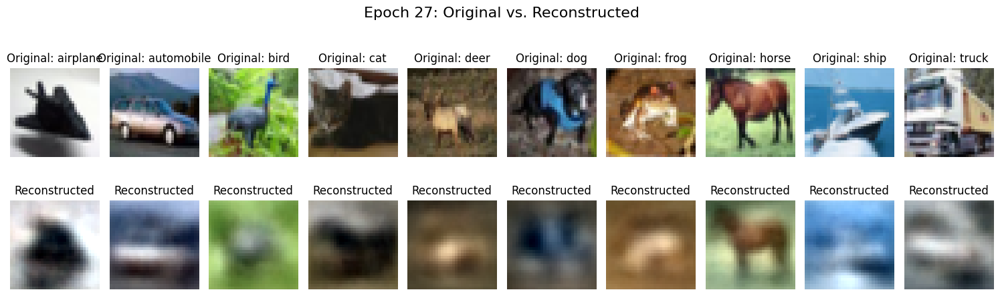

 90%|█████████ | 27/30 [51:32<05:45, 115.29s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


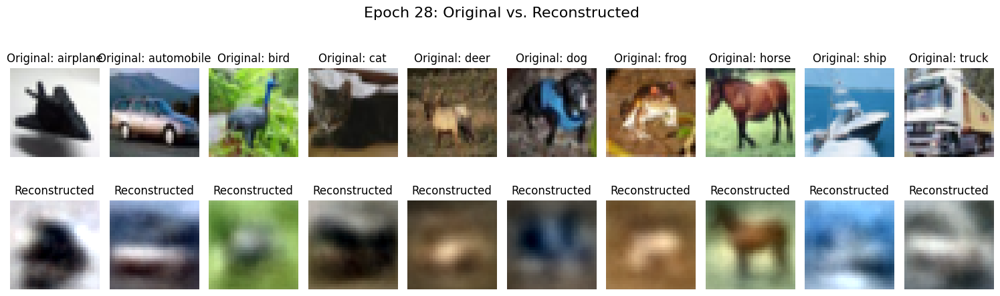

 93%|█████████▎| 28/30 [53:26<03:49, 114.90s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


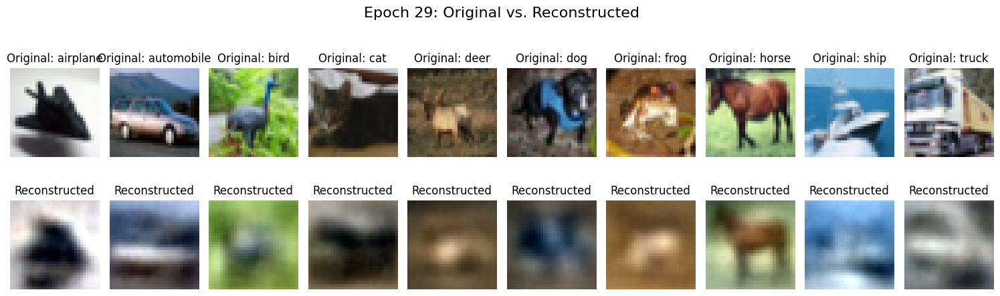

 97%|█████████▋| 29/30 [55:20<01:54, 114.80s/it]WARNING:matplotlib.image:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


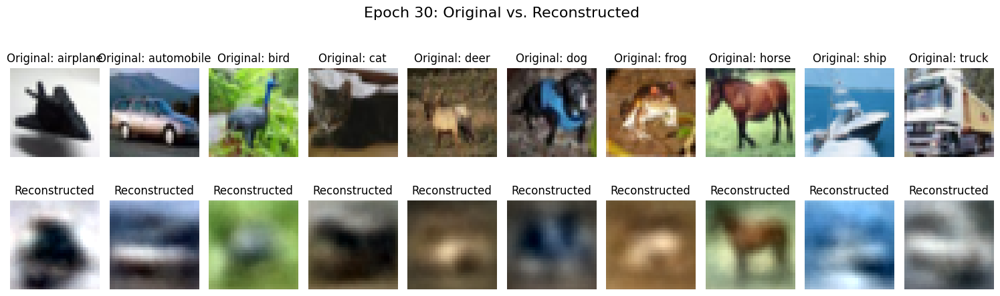

100%|██████████| 30/30 [57:16<00:00, 114.53s/it]


In [58]:
epochs = 30
for e in tqdm(range(epochs)):
    for X, label in train_loader:
        X = X.to(torch.float32)
        X_hat = auto_encoder(X)
        loss = criterion(X_hat, X)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    display_reconstructions(auto_encoder, train_dataset, e, device)

In [59]:
torch.save(auto_encoder.state_dict(), 'cifar_auto_encoder_30.pt')